## 3.2 Compare  accuracy of document classification if more/different information is added to description

### 3.2.1 Document classification using Title only

In [ ]:
# to create word embeddings of title, we need to first read the titles
titles = []
with open("job_title.txt", "r") as file:
    
    title = file.readline()
    
    while title:
        titles.append(title[:-1])
        title = file.readline()
titles  

['Plant Engineer',
 'Residential Care Worker',
 'CHEF DE RANG FOR MICHELIN STARRED RESTAURANT',
 'Inpatient Ward Team Leader',
 'Information Services Support Analyst',
 'Physiotherapist  Cambridge',
 'Youth Justice Officer Job Luton',
 'Front End Web Developer  Slough  ****k****k',
 'NET / Web Developer  Clayton West, Huddersfield, West Yorkshire',
 'Senior Account Manager (Telecoms / IT)',
 'IT Project Manager (C/ASPnet) ****K Leicester',
 'Cisco Call Manager Technician  Greater Manchester',
 'Senior Nurse  Small Specialist Care Home',
 'Senior Oracle DBA/Database AdministratorNorth Yorkshire',
 'Cluster Sales Manager  Maternity Cover',
 'Software Build Manager, MSBuild',
 'Electrical Fitter  Crawley ,Sussex',
 'Sales Manager Door Automation',
 'Year ****/6 Teacher, Cannock',
 'Experienced KS****/KS**** Science teacher Braintree',
 'Design Engineer  Software and Firmware (Python)',
 'C Developer  Top Asset Management Firm',
 'Senior Javascript developer',
 'RESEARCHER, BOLTON',
 'Seni

In [ ]:
def tokenizeAds(raw_job_ad):
    """
        This function segments the raw job description into sentences and 
        tokenize each sentences and convert the description 
        to a list of tokens.
    """        
    
    # perform sentence segmentation (i.e. segment each description text into sentences),
    sentences = sent_tokenize(raw_job_ad)
    
#     print(sentences)
    
    # tokenize each sentence
    pattern = r'''[a-zA-Z]+(?:[-'][a-zA-Z]+)?'''

    # initialise tokenizer based on regex pattern
    tokenizer = RegexpTokenizer(pattern) 

    token_lists = [tokenizer.tokenize(sen) for sen in sentences]
    
    # merge them into a list of tokens
    tokenised_job_ad = list(chain.from_iterable(token_lists))
    
    return tokenised_job_ad

In [ ]:
# tokenzise each title
tokenized_job_titles = [tokenizeAds(title) for title in titles] 

In [ ]:
tokenized_job_titles

[['Plant', 'Engineer'],
 ['Residential', 'Care', 'Worker'],
 ['CHEF', 'DE', 'RANG', 'FOR', 'MICHELIN', 'STARRED', 'RESTAURANT'],
 ['Inpatient', 'Ward', 'Team', 'Leader'],
 ['Information', 'Services', 'Support', 'Analyst'],
 ['Physiotherapist', 'Cambridge'],
 ['Youth', 'Justice', 'Officer', 'Job', 'Luton'],
 ['Front', 'End', 'Web', 'Developer', 'Slough', 'k', 'k'],
 ['NET',
  'Web',
  'Developer',
  'Clayton',
  'West',
  'Huddersfield',
  'West',
  'Yorkshire'],
 ['Senior', 'Account', 'Manager', 'Telecoms', 'IT'],
 ['IT', 'Project', 'Manager', 'C', 'ASPnet', 'K', 'Leicester'],
 ['Cisco', 'Call', 'Manager', 'Technician', 'Greater', 'Manchester'],
 ['Senior', 'Nurse', 'Small', 'Specialist', 'Care', 'Home'],
 ['Senior', 'Oracle', 'DBA', 'Database', 'AdministratorNorth', 'Yorkshire'],
 ['Cluster', 'Sales', 'Manager', 'Maternity', 'Cover'],
 ['Software', 'Build', 'Manager', 'MSBuild'],
 ['Electrical', 'Fitter', 'Crawley', 'Sussex'],
 ['Sales', 'Manager', 'Door', 'Automation'],
 ['Year', 'Te

In [ ]:
len(tokenized_job_titles)

55449

In [ ]:
# check a few tokenizers
print(titles[3:5])
print(tokenized_job_titles[3:5])

['Inpatient Ward Team Leader', 'Information Services Support Analyst']
[['Inpatient', 'Ward', 'Team', 'Leader'], ['Information', 'Services', 'Support', 'Analyst']]


In [ ]:
# check a few tokenizers
print(titles[7])
print(tokenized_job_titles[7])

Front End Web Developer  Slough  ****k****k
['Front', 'End', 'Web', 'Developer', 'Slough', 'k', 'k']


In [ ]:
# check a few tokenizers
print(titles[7445])
print(tokenized_job_titles[7445])

RMN  Eating Disorders  Barnet
['RMN', 'Eating', 'Disorders', 'Barnet']


In [ ]:
# check a few tokenizers
print(titles[2804])
print(tokenized_job_titles[2804])

Product Design Engineer  Great Brands Cambridgeshire
['Product', 'Design', 'Engineer', 'Great', 'Brands', 'Cambridgeshire']


In [ ]:
# method to print few statistics about the tokensized list

def stats_print(tokenized_job_desc):
    
    # put all the tokens in the corpus in a single list
    words = list(chain.from_iterable(tokenized_job_desc)) 
    
    # compute the vocabulary by converting the list of words/tokens to a set,
    vocab = set(words) 
    
    # diverity of words respective of all the words in the corpus
    lexical_diversity = len(vocab)/len(words)
    
    lens = [len(job) for job in tokenized_job_desc]
    
    print("Vocabulary size: ",len(vocab))
    print("Total number of tokens: ", len(words))
    print("Lexical diversity: ", lexical_diversity)
    print("Total number of job_ad: ", len(tokenized_job_desc))
    print("Average number of tokens in job descriptions: ", np.mean(lens))
    print("Maximun number of tokens in job descriptions: ", np.max(lens))
    print("Minimun number of tokens in job descriptions: ", np.min(lens))
    print("Standard deviation of number of tokens in job descriptions: ", np.std(lens))

In [ ]:
stats_print(tokenized_job_titles)

Vocabulary size:  14511
Total number of tokens:  276946
Lexical diversity:  0.052396496067825496
Total number of job_ad:  55449
Average number of tokens in job descriptions:  4.994607657487061
Maximun number of tokens in job descriptions:  22
Minimun number of tokens in job descriptions:  0
Standard deviation of number of tokens in job descriptions:  2.0417798268217875


In [ ]:
# some tokens are empty as observed from statistics above

for ind, token in enumerate(tokenized_job_titles):
    if len(token) == 0:
        print(ind, token)

10567 []


In [ ]:
# converting all to lower case
tokenized_job_title_lower = []

for i in range(0, len(tokenized_job_titles)):
    
    # convert each token to lower case
    # create a new list with all lower case tokens for each toeknised job description
    tokenized_job_title_lower.append([token.lower() for token in tokenized_job_titles[i]])
   

In [ ]:
print("Total number of job_ad:", len(tokenized_job_title_lower))

Total number of job_ad: 55449


In [ ]:
tokenized_job_title_lower[0]

['plant', 'engineer']

In [ ]:
stats_print(tokenized_job_title_lower)

Vocabulary size:  10854
Total number of tokens:  276946
Lexical diversity:  0.0391917557935482
Total number of job_ad:  55449
Average number of tokens in job descriptions:  4.994607657487061
Maximun number of tokens in job descriptions:  22
Minimun number of tokens in job descriptions:  0
Standard deviation of number of tokens in job descriptions:  2.0417798268217875


In [ ]:
# remove words with length less than 2

lowercase_tokens_lenGreater2_title = [[lowercase_token for lowercase_token in title if len(lowercase_token) >= 2] for title in tokenized_job_title_lower]



In [ ]:
# check a few tokenizers
print("Tokenized review WITH single character words:\n\n", tokenized_job_title_lower[7])

Tokenized review WITH single character words:

 ['front', 'end', 'web', 'developer', 'slough', 'k', 'k']


In [ ]:
# check a few tokenizers
print("Tokenized review WITHOUT any single character word:\n\n",lowercase_tokens_lenGreater2_title[7])

Tokenized review WITHOUT any single character word:

 ['front', 'end', 'web', 'developer', 'slough']


In [ ]:
print("Tokenized review WITH single character words:\n\n", tokenized_job_title_lower[7445])

Tokenized review WITH single character words:

 ['rmn', 'eating', 'disorders', 'barnet']


In [ ]:
print("Tokenized review WITHOUT any single character word:\n\n",lowercase_tokens_lenGreater2_title[7445])

Tokenized review WITHOUT any single character word:

 ['rmn', 'eating', 'disorders', 'barnet']


In [ ]:
stats_print(lowercase_tokens_lenGreater2_title)


Vocabulary size:  10828
Total number of tokens:  267204
Lexical diversity:  0.040523345458900316
Total number of job_ad:  55449
Average number of tokens in job descriptions:  4.818914678353082
Maximun number of tokens in job descriptions:  22
Minimun number of tokens in job descriptions:  0
Standard deviation of number of tokens in job descriptions:  1.918071249456622


In [ ]:
# read the stop words into a list data structure
stopwords_list = []

with open('./stopwords_en.txt') as f:
    
    stopwords_list = f.read().splitlines()

In [ ]:
# remove stop words
# use list comprehension

tokens_without_stopwords = [[word for word in job if word not in stopwords_list] for job in lowercase_tokens_lenGreater2_title]


In [ ]:
len(tokens_without_stopwords)

55449

In [ ]:
stats_print(tokens_without_stopwords)

Vocabulary size:  10621
Total number of tokens:  252719
Lexical diversity:  0.042026915269528606
Total number of job_ad:  55449
Average number of tokens in job descriptions:  4.55768363721618
Maximun number of tokens in job descriptions:  20
Minimun number of tokens in job descriptions:  0
Standard deviation of number of tokens in job descriptions:  1.710492073060186


In [ ]:
# create a list of all the words used in the corpus
words = list(chain.from_iterable(tokens_without_stopwords)) 

In [ ]:
len(words)

252719

In [ ]:
# compute term frequency for all words
term_fd = FreqDist(words) 

In [ ]:
# observe the 25 most common words in the corpus
term_fd.most_common(25)

[('manager', 10735),
 ('engineer', 6176),
 ('sales', 4617),
 ('developer', 4614),
 ('senior', 4115),
 ('london', 3316),
 ('analyst', 2912),
 ('support', 2674),
 ('nurse', 2609),
 ('assistant', 2426),
 ('executive', 2183),
 ('business', 2161),
 ('chef', 2151),
 ('consultant', 2002),
 ('software', 1906),
 ('account', 1669),
 ('care', 1564),
 ('project', 1508),
 ('development', 1456),
 ('rgn', 1301),
 ('home', 1292),
 ('teacher', 1217),
 ('technical', 1214),
 ('web', 1204),
 ('service', 1177)]

In [ ]:
# find out the list of words that appear only once in the entire corpus
lessFreqWords = set(term_fd.hapaxes())
lessFreqWords

{'cca',
 'praha',
 'gsm',
 'oper',
 'ingres',
 'otolaryngology',
 'sessions',
 'tap',
 'testingsurrey',
 'hadlow',
 'abs',
 'slovakia',
 'friend',
 'ftp',
 'batley',
 'esign',
 'kfc',
 'partiemultirosette',
 'bte',
 'elveden',
 'bulge',
 'demonstratorandover',
 'jvm',
 'nursrey',
 'managerexciting',
 'communcations',
 'dems',
 'seniorprogressiontop',
 'hacker',
 'developercambridge',
 'oakhurst',
 'msoffice',
 'mvp',
 'eggy',
 'settler',
 'guideline',
 'rick',
 'administratortelephone',
 'multioultet',
 'plains',
 'endoscope',
 'dwdm',
 'conditions',
 'mompesson',
 'australian',
 'blyth',
 'caseworking',
 'anaesethetics',
 'pnuematic',
 'wellheads',
 'erate',
 'callaboration',
 'mixers',
 'grampian',
 'sequencer',
 'speiclaist',
 'scoping',
 'inflation',
 'cercasi',
 'urgentmaths',
 'muswell',
 'operationsimmediate',
 'hanwell',
 'homebeautiful',
 'rose',
 'amada',
 'shd',
 'metro',
 'companies',
 'ophthalmics',
 'caretaunton',
 'concessions',
 'publ',
 'longford',
 'vaccinations',
 'e

In [ ]:
# remove these less frequent words from each tokenized job description
def removeLessFreqWords(ad):
    return [w for w in ad if w not in lessFreqWords]

In [ ]:
tokens_removeLessTermFreq = [removeLessFreqWords(job) for job in tokens_without_stopwords]

In [ ]:
stats_print(tokens_removeLessTermFreq)

Vocabulary size:  5651
Total number of tokens:  247749
Lexical diversity:  0.022809375618065057
Total number of job_ad:  55449
Average number of tokens in job descriptions:  4.468051723205107
Maximun number of tokens in job descriptions:  18
Minimun number of tokens in job descriptions:  0
Standard deviation of number of tokens in job descriptions:  1.7104599400476832


In [ ]:
# get all the unique words and flatten it to a list
# documnet frequency gives frequency of all words across all the document collection

words_2 = list(chain.from_iterable([set(job) for job in tokens_removeLessTermFreq]))
doc_fd = FreqDist(words_2)  
doc_fd.most_common(50)

[('manager', 10433),
 ('engineer', 6024),
 ('developer', 4447),
 ('sales', 4300),
 ('senior', 4092),
 ('london', 3237),
 ('analyst', 2832),
 ('support', 2560),
 ('nurse', 2530),
 ('assistant', 2402),
 ('executive', 2140),
 ('business', 2116),
 ('chef', 2090),
 ('consultant', 1971),
 ('software', 1848),
 ('account', 1606),
 ('care', 1499),
 ('project', 1472),
 ('development', 1449),
 ('rgn', 1297),
 ('home', 1237),
 ('technical', 1202),
 ('teacher', 1195),
 ('web', 1170),
 ('service', 1162),
 ('marketing', 1140),
 ('sql', 1101),
 ('lead', 1080),
 ('design', 1006),
 ('head', 970),
 ('systems', 967),
 ('services', 923),
 ('administrator', 920),
 ('net', 906),
 ('team', 877),
 ('west', 864),
 ('financial', 842),
 ('restaurant', 834),
 ('graduate', 833),
 ('staff', 830),
 ('java', 821),
 ('general', 821),
 ('technician', 820),
 ('worker', 806),
 ('de', 782),
 ('junior', 757),
 ('finance', 757),
 ('digital', 742),
 ('aspnet', 735),
 ('hotel', 735)]

In [ ]:
# find the 50 most frequent words all the documents
document_freq = doc_fd.most_common(50)
document_freq 

[('manager', 10433),
 ('engineer', 6024),
 ('developer', 4447),
 ('sales', 4300),
 ('senior', 4092),
 ('london', 3237),
 ('analyst', 2832),
 ('support', 2560),
 ('nurse', 2530),
 ('assistant', 2402),
 ('executive', 2140),
 ('business', 2116),
 ('chef', 2090),
 ('consultant', 1971),
 ('software', 1848),
 ('account', 1606),
 ('care', 1499),
 ('project', 1472),
 ('development', 1449),
 ('rgn', 1297),
 ('home', 1237),
 ('technical', 1202),
 ('teacher', 1195),
 ('web', 1170),
 ('service', 1162),
 ('marketing', 1140),
 ('sql', 1101),
 ('lead', 1080),
 ('design', 1006),
 ('head', 970),
 ('systems', 967),
 ('services', 923),
 ('administrator', 920),
 ('net', 906),
 ('team', 877),
 ('west', 864),
 ('financial', 842),
 ('restaurant', 834),
 ('graduate', 833),
 ('staff', 830),
 ('java', 821),
 ('general', 821),
 ('technician', 820),
 ('worker', 806),
 ('de', 782),
 ('junior', 757),
 ('finance', 757),
 ('digital', 742),
 ('aspnet', 735),
 ('hotel', 735)]

In [ ]:
freq_words = []

for word in document_freq:
    freq_words.append(word[0])
    
print(freq_words)
print("\n")
print(len(freq_words ))

['manager', 'engineer', 'developer', 'sales', 'senior', 'london', 'analyst', 'support', 'nurse', 'assistant', 'executive', 'business', 'chef', 'consultant', 'software', 'account', 'care', 'project', 'development', 'rgn', 'home', 'technical', 'teacher', 'web', 'service', 'marketing', 'sql', 'lead', 'design', 'head', 'systems', 'services', 'administrator', 'net', 'team', 'west', 'financial', 'restaurant', 'graduate', 'staff', 'java', 'general', 'technician', 'worker', 'de', 'junior', 'finance', 'digital', 'aspnet', 'hotel']


50


In [ ]:
def removeTop50(ad):
    return [w for w in ad if w not in freq_words]

In [ ]:
tokens_removeMostDocumentFreq = [removeTop50(ad) for ad in tokens_removeLessTermFreq]

In [ ]:
stats_print(tokens_removeMostDocumentFreq)

Vocabulary size:  5601
Total number of tokens:  157176
Lexical diversity:  0.03563521148266911
Total number of job_ad:  55449
Average number of tokens in job descriptions:  2.834604771952605
Maximun number of tokens in job descriptions:  15
Minimun number of tokens in job descriptions:  0
Standard deviation of number of tokens in job descriptions:  1.5886924846468733


In [ ]:
words_title = list(chain.from_iterable(tokens_removeMostDocumentFreq))

In [ ]:
# vocab is all the unique words
vocab_title = set(words_title)

In [ ]:
vocab_title = sorted(list(vocab_title))

In [ ]:
len(vocab_title)

5601

In [ ]:
out_file = open("vocab_title.txt", 'w')

for ind in range(0, len(vocab_title)):
    out_file.write("{}:{}\n".format(vocab_title[ind],ind)) # write each index and vocabulary word, note that index start from 0
out_file.close() # close the file

In [ ]:
tokenized_titles = tokens_removeMostDocumentFreq

In [ ]:
tokenized_titles

[['plant'],
 ['residential'],
 ['rang', 'michelin', 'starred'],
 ['inpatient', 'ward', 'leader'],
 ['information'],
 ['physiotherapist', 'cambridge'],
 ['youth', 'officer', 'job', 'luton'],
 ['front', 'end', 'slough'],
 ['huddersfield', 'yorkshire'],
 ['telecoms'],
 ['leicester'],
 ['cisco', 'call', 'greater', 'manchester'],
 ['small', 'specialist'],
 ['oracle', 'dba', 'database', 'administratornorth', 'yorkshire'],
 ['cluster', 'maternity', 'cover'],
 ['build'],
 ['electrical', 'fitter', 'crawley', 'sussex'],
 ['door', 'automation'],
 ['year', 'cannock'],
 ['experienced', 'ks', 'ks', 'science', 'braintree'],
 ['firmware', 'python'],
 ['top', 'asset', 'management', 'firm'],
 ['javascript'],
 ['researcher', 'bolton'],
 ['sous', 'banqueting', 'events', 'bonus'],
 ['carer', 'halifax'],
 ['nursing', 'hereford', 'worcester'],
 ['mid'],
 ['guildford', 'surrey'],
 ['product', 'specialist', 'watford', 'herts'],
 ['sharepoint', 'architect', 'basingstoke', 'pound'],
 ['product', 'control', 'auto

In [ ]:
tokenized_titles = [" ".join(token) for token in tokenized_titles]

In [ ]:
tokenized_titles

['plant',
 'residential',
 'rang michelin starred',
 'inpatient ward leader',
 'information',
 'physiotherapist cambridge',
 'youth officer job luton',
 'front end slough',
 'huddersfield yorkshire',
 'telecoms',
 'leicester',
 'cisco call greater manchester',
 'small specialist',
 'oracle dba database administratornorth yorkshire',
 'cluster maternity cover',
 'build',
 'electrical fitter crawley sussex',
 'door automation',
 'year cannock',
 'experienced ks ks science braintree',
 'firmware python',
 'top asset management firm',
 'javascript',
 'researcher bolton',
 'sous banqueting events bonus',
 'carer halifax',
 'nursing hereford worcester',
 'mid',
 'guildford surrey',
 'product specialist watford herts',
 'sharepoint architect basingstoke pound',
 'product control automation components',
 'qcf hospitality catering assessor essex',
 'mechanical catia',
 'sous luxury aa rosette fantastic group',
 'stock taker',
 'oracle cutting edge trading',
 '',
 'qa test tester',
 'ks foundati

In [ ]:
len(tokenized_titles)

55449

#### Bag of Words model for Title

In [ ]:
cVectorizerTitle = CountVectorizer(analyzer = "word", vocabulary = vocab_title, binary=False)

In [ ]:
cVectorizerTitle

CountVectorizer(vocabulary=['aa', 'aar', 'aat', 'ab', 'abap', 'abbot',
                            'aberdeen', 'aberdeenshire', 'abi', 'abingdon',
                            'abm', 'abrasives', 'abu', 'ac', 'aca', "aca's",
                            'academic', 'academics', 'academy', 'acc', 'acca',
                            'acceptance', 'access', 'accessories', 'accident',
                            'accidental', 'acclaimed', 'accom', 'accommodation',
                            'accomodation', ...])

In [ ]:
# fit the model on job descriptions
count_features_title = cVectorizerTitle.fit_transform(tokenized_titles)

In [ ]:
print(count_features_title.shape)

(55449, 5601)


In [ ]:
count_features_title

<55449x5601 sparse matrix of type '<class 'numpy.int64'>'
	with 154792 stored elements in Compressed Sparse Row format>

In [ ]:
# a method to validate count features or tfidf features generated for a given job index

def validator(data_features, vocab, a_ind, tokenized_titles):
    
    # print out the tokens of the job
    print("Tokens: \n")
    print(tokenized_titles[a_ind])
    
    print("--------------------------------------------\n")
    
    print("Vector representation:\n") 
    
    for word, value in zip(vocab, data_features.toarray()[a_ind]): 
        if value > 0:
            print(word+":"+str(value), end =' ')
                       

In [ ]:
validator(count_features_title, vocab_title, 7, tokenized_titles)

Tokens: 

front end slough
--------------------------------------------

Vector representation:

end:1 front:1 slough:1 

In [ ]:
validator(count_features_title, vocab_title, 10567, tokenized_titles)

Tokens: 


--------------------------------------------

Vector representation:



In [ ]:
validator(count_features_title, vocab_title, 10568, tokenized_titles)

Tokens: 

cover supervisor havering asap start
--------------------------------------------

Vector representation:

asap:1 cover:1 havering:1 start:1 supervisor:1 

In [ ]:
count_features_title

<55449x5601 sparse matrix of type '<class 'numpy.int64'>'
	with 154792 stored elements in Compressed Sparse Row format>

In [ ]:
# generate tdidf vectors for generating weighted word embeddings of decriptions

tVectorizerTitle = TfidfVectorizer(analyzer = "word",vocabulary = vocab_title) # initialised the TfidfVectorizer

tfidf_features_title = tVectorizerTitle.fit_transform(tokenized_titles) # generate the tfidf vector representation for all articles

tfidf_features_title.shape


(55449, 5601)

In [ ]:
tfidf_features_title

<55449x5601 sparse matrix of type '<class 'numpy.float64'>'
	with 154792 stored elements in Compressed Sparse Row format>

In [ ]:
validator(tfidf_features_title, vocab_title, 10568, tokenized_titles)

Tokens: 

cover supervisor havering asap start
--------------------------------------------

Vector representation:

asap:0.43233950298047474 cover:0.3996906448992963 havering:0.6283144949680687 start:0.36968324521940465 supervisor:0.34912051810177347 

In [ ]:
validator(tfidf_features_title, vocab_title, 10567, tokenized_titles)

Tokens: 


--------------------------------------------

Vector representation:



In [ ]:
validator(tfidf_features_title, vocab_title, 16810, tokenized_titles)

Tokens: 

rmn deputy
--------------------------------------------

Vector representation:

deputy:0.7164106219593234 rmn:0.6976788808211521 

In [ ]:
# save the generated tfidf vectors to train the weighted models later in the tasks

def write_vectorFile_further(data_features, filename):
    
    # the number of document
    num = data_features.shape[0] 

    
    # creates a txt file and open to save the vector representation
    out_file = open(filename, 'w') 
    
    for a_ind in range(0, num): # loop through each description by index

        for f_ind in data_features[a_ind].nonzero()[1]: 
        
            # retrieve the value of the entry from data_features
            value = data_features[a_ind][0,f_ind] 
            
            # write the entry to the file in the format of word_index:value
            out_file.write("{}:{} ".format(f_ind, value)) 
               
        out_file.write('\n') # start a new line after each description
        
    out_file.close() # close the file

In [ ]:
write_vectorFile_further(tfidf_features_title, "tfidf_features_title.txt")

In [ ]:
write_vectorFile_further(count_features_title, "count_features_title.txt")

#### methods to assist building weighted and unweighted models

In [ ]:
# we will need to create a corpus of all the tokenized and pre-processed job description for further use in the task

with open("corpus_title.txt", "w") as file:
    
    for i in range(0, len(tokenized_titles)):
        file.write(tokenized_titles[i] + "\n")

In [ ]:
filename = 'corpus_title.txt'

with open(filename) as txtf:
    description_txts = txtf.read().splitlines() # reading a list of strings, each for a document/article
    
tokenized_titles_list = [a.split(' ') for a in description_txts]

In [ ]:
tokenized_titles_list

[['plant'],
 ['residential'],
 ['rang', 'michelin', 'starred'],
 ['inpatient', 'ward', 'leader'],
 ['information'],
 ['physiotherapist', 'cambridge'],
 ['youth', 'officer', 'job', 'luton'],
 ['front', 'end', 'slough'],
 ['huddersfield', 'yorkshire'],
 ['telecoms'],
 ['leicester'],
 ['cisco', 'call', 'greater', 'manchester'],
 ['small', 'specialist'],
 ['oracle', 'dba', 'database', 'administratornorth', 'yorkshire'],
 ['cluster', 'maternity', 'cover'],
 ['build'],
 ['electrical', 'fitter', 'crawley', 'sussex'],
 ['door', 'automation'],
 ['year', 'cannock'],
 ['experienced', 'ks', 'ks', 'science', 'braintree'],
 ['firmware', 'python'],
 ['top', 'asset', 'management', 'firm'],
 ['javascript'],
 ['researcher', 'bolton'],
 ['sous', 'banqueting', 'events', 'bonus'],
 ['carer', 'halifax'],
 ['nursing', 'hereford', 'worcester'],
 ['mid'],
 ['guildford', 'surrey'],
 ['product', 'specialist', 'watford', 'herts'],
 ['sharepoint', 'architect', 'basingstoke', 'pound'],
 ['product', 'control', 'auto

In [ ]:
tokenized_titles_list[10567]

['']

In [ ]:
# method to generate vector representation for documents - unweighted
def gen_docVecs(wv, tk_txts): 
    
    # creating empty final dataframe
    docs_vectors = pd.DataFrame()

    for i in range(0, len(tk_txts)):
        tokens = tk_txts[i]
        
        # creating a temporary dataframe(store value for 1st doc & for 2nd doc remove the details of 1st & proced through 2nd and so on..)
        temp = pd.DataFrame()  
        
        # looping through each word of a single document and spliting through space
        for w_ind in range(0, len(tokens)): 
            try:
                word = tokens[w_ind]
                
                # if word is present in embeddings(goole provides weights associate with words(300)) then proceed
                word_vec = wv[word] 
                
                # if word is present then append it to temporary dataframe
                temp = temp.append(pd.Series(word_vec), ignore_index = True) 
            except:
                pass
            
        # take the sum of each column    
        doc_vector = temp.sum() 
        
        # append each document value to the final dataframe
        docs_vectors = docs_vectors.append(doc_vector, ignore_index = True) 
    return docs_vectors

In [ ]:
df_title = pd.read_csv('ids_categories.csv')

In [ ]:
df_title.head(15)

,Unnamed: 0,Job_ID,Category
0,0,14624,Engineering
1,1,31567,Healthcare_Nursing
2,2,50131,Hospitality_Catering
3,3,31419,Healthcare_Nursing
4,4,47238,Teaching
5,5,36205,Healthcare_Nursing
6,6,30175,Healthcare_Nursing
7,7,54070,PR_Advertising_Marketing
8,8,5781,IT
9,9,44021,Sales


In [ ]:
df_title.drop("Unnamed: 0", axis=1, inplace= True)

In [ ]:
df_title.shape

(55449, 2)

In [ ]:
df_title['title_text'] = tokenized_titles

In [ ]:
df_title['tk_title_text'] = tokenized_titles_list

In [ ]:
df_title.head()

,Job_ID,Category,title_text,tk_title_text
0,14624,Engineering,plant,[plant]
1,31567,Healthcare_Nursing,residential,[residential]
2,50131,Hospitality_Catering,rang michelin starred,"[rang, michelin, starred]"
3,31419,Healthcare_Nursing,inpatient ward leader,"[inpatient, ward, leader]"
4,47238,Teaching,information,[information]


In [ ]:
df_title[df_title["Job_ID"] == 14392]

,Job_ID,Category,title_text,tk_title_text
10567,14392,Engineering,,[]


In [ ]:
df_title[df_title["Job_ID"] == 14392]["tk_title_text"]

10567    []
Name: tk_title_text, dtype: object

In [ ]:
df_title.index[df_title['Job_ID'] == 14392].tolist()

[10567]

In [ ]:
def plotTSNE(labels,features): # features as a numpy array, each element of the array is the document embedding of an article
    categories = sorted(labels.unique())
    # Sampling a subset of our dataset because t-SNE is computationally expensive
    SAMPLE_SIZE = int(len(features) * 0.3)
    np.random.seed(0)
    indices = np.random.choice(range(len(features)), size=SAMPLE_SIZE, replace=False)
    projected_features = TSNE(n_components=2, random_state=0).fit_transform(features[indices])
    colors = ['pink', 'green', 'midnightblue', 'orange', 'darkgrey', 'red', 'blue', 'black']
    for i in range(0,len(categories)):
        points = projected_features[(labels[indices] == categories[i])]
        plt.scatter(points[:, 0], points[:, 1], s=30, c=colors[i], label=categories[i])
    plt.title("Feature vector for each article, projected on 2 dimensions.",
              fontdict=dict(fontsize=15))
    plt.legend()
    plt.show()

In [ ]:
# extended version of the `gen_docVecs` function

def gen_docVecs(wv,tk_txts,tfidf = []): # generate vector representation for documents
    docs_vectors = pd.DataFrame() # creating empty final dataframe
    #stopwords = nltk.corpus.stopwords.words('english') # removing stop words

    for i in range(0,len(tk_txts)):
        tokens = list(set(tk_txts[i])) # get the list of distinct words of the document

        temp = pd.DataFrame()  # creating a temporary dataframe(store value for 1st doc & for 2nd doc remove the details of 1st & proced through 2nd and so on..)
        for w_ind in range(0, len(tokens)): # looping through each word of a single document and spliting through space
            try:
                word = tokens[w_ind]
                word_vec = wv[word] # if word is present in embeddings(goole provides weights associate with words(300)) then proceed
                
                if tfidf != []:
                    word_weight = float(tfidf[i][word])
                else:
                    word_weight = 1
                temp = temp.append(pd.Series(word_vec*word_weight), ignore_index = True) # if word is present then append it to temporary dataframe
            except:
                pass
        doc_vector = temp.sum() # take the sum of each column(w0, w1, w2,........w300)
        docs_vectors = docs_vectors.append(doc_vector, ignore_index = True) # append each document value to the final dataframe
    return docs_vectors

### Generate word embeddings

#### FastText Unweighted --->  title 

In [ ]:
from gensim.models.fasttext import FastText

# 1. Set the corpus file names/path
corpus_file = 'corpus_title.txt'

# 2. Initialise the Fast Text model
jobAdFT_title = FastText(vector_size=200) 

# 3. build the vocabulary
jobAdFT_title.build_vocab(corpus_file=corpus_file)

# 4. train the model
jobAdFT_title.train(
    corpus_file=corpus_file, epochs=jobAdFT_title.epochs,
    total_examples=jobAdFT_title.corpus_count, total_words=jobAdFT_title.corpus_total_words,
)

print(jobAdFT_title)

FastText(vocab=3121, vector_size=200, alpha=0.025)


In [ ]:
# fetch and assign all the vectors/word embeddings to a new variable
jobAdFT_wv = jobAdFT_title.wv
print(jobAdFT_wv)

In [ ]:
len(jobAdFT_wv)

3121

In [ ]:
# check the embedding of each word
jobAdFT_wv.vector_size

200

In [ ]:
for index, word in enumerate(jobAdFT_wv.index_to_key):
    if index == 10:
        break
    print(f"word #{index}/{len(jobAdFT_wv.index_to_key)} is {word}")

word #0/3121 is registered
word #1/3121 is specialist
word #2/3121 is mechanical
word #3/3121 is health
word #4/3121 is partie
word #5/3121 is field
word #6/3121 is management
word #7/3121 is accountant
word #8/3121 is contract
word #9/3121 is leader


In [ ]:
jobAdFT_title.save("jobAdFT_title.model")

In [ ]:
jobAdFT = FastText.load("jobAdFT_title.model")

print(jobAdFT)

jobAdFT_wv = jobAdFT.wv

FastText(vocab=3121, vector_size=200, alpha=0.025)


In [ ]:
jobAdFT_wv

In [ ]:
# generate document embeddings
jobAdFT_title_dvs = gen_docVecs(jobAdFT_wv, df_title['tk_title_text'])

jobAdFT_title_dvs.isna().any().sum()

0

In [ ]:
jobAdFT_title_dvs.shape

(55449, 200)

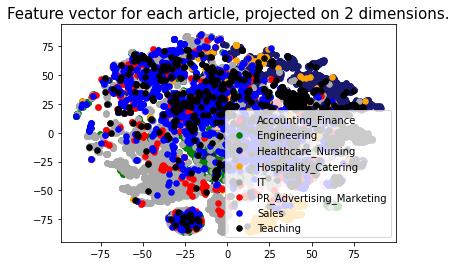

In [ ]:
# explore feature space
features = jobAdFT_title_dvs.to_numpy()

plotTSNE(df_title['Category'], features)

## <span style='font-family:Georgia;color:Blue;background:yellow'> observation
    
1. `Hospitality _Categring` cluster is well distinguisable while other clusters seem to overlap a lot. 
    
    
2. Titles of IT, Engineering, Teacher seem to have a lot in common and are not distinguisable. 

In [ ]:
jobAdFT_title_dvs.to_csv('jobAdFT_title_unweighted.csv') 

In [ ]:
# read the csv file into a dataframe when the notebook restarts

jobAdFT_title_dvs = pd.read_csv('jobAdFT_title_unweighted.csv')

In [ ]:
jobAdFT_title_dvs.head()

,Unnamed: 0,0,1,2,3,4,5,6,7,8,...,190,191,192,193,194,195,196,197,198,199
0,0,-0.405108,0.330389,0.118105,-0.366484,0.168660,-0.142718,0.085553,-0.341884,0.154156,...,0.105820,-0.179472,0.453477,-0.271049,-0.172683,0.317887,-0.284693,-0.045117,0.190313,0.445581
1,1,-0.558373,0.038598,0.101644,-0.256095,0.231820,-0.083567,0.000725,-0.265386,0.169778,...,-0.055848,-0.046661,0.244906,-0.233067,-0.292221,0.147369,-0.135262,0.183647,0.171105,0.569871
2,2,-1.079785,-0.042170,0.581533,-0.042811,0.379733,-0.293380,-0.148715,-1.109385,-0.157195,...,0.412096,0.196686,1.729643,-0.312747,-0.199897,-0.565334,-0.504295,0.953583,0.307474,0.512590
3,3,-1.287268,0.207396,0.441910,-0.552387,0.421162,-0.290087,-0.084204,-0.910076,0.289969,...,0.407149,0.001939,1.217267,-0.467717,-0.502140,0.238107,-0.506400,0.208123,0.527144,0.962653
4,4,-0.512066,0.571129,0.096740,-0.501300,0.140151,-0.334073,-0.007702,-0.643639,0.138520,...,0.082651,-0.308811,0.580805,-0.456250,0.013246,0.251560,-0.159707,-0.257947,0.262074,0.176060


In [ ]:
jobAdFT_title_dvs.drop("Unnamed: 0", axis=1, inplace=True)

In [ ]:
jobAdFT_title_dvs.head()

,0,1,2,3,4,5,6,7,8,9,...,190,191,192,193,194,195,196,197,198,199
0,-0.405108,0.330389,0.118105,-0.366484,0.168660,-0.142718,0.085553,-0.341884,0.154156,-0.199711,...,0.105820,-0.179472,0.453477,-0.271049,-0.172683,0.317887,-0.284693,-0.045117,0.190313,0.445581
1,-0.558373,0.038598,0.101644,-0.256095,0.231820,-0.083567,0.000725,-0.265386,0.169778,-0.022768,...,-0.055848,-0.046661,0.244906,-0.233067,-0.292221,0.147369,-0.135262,0.183647,0.171105,0.569871
2,-1.079785,-0.042170,0.581533,-0.042811,0.379733,-0.293380,-0.148715,-1.109385,-0.157195,-0.750410,...,0.412096,0.196686,1.729643,-0.312747,-0.199897,-0.565334,-0.504295,0.953583,0.307474,0.512590
3,-1.287268,0.207396,0.441910,-0.552387,0.421162,-0.290087,-0.084204,-0.910076,0.289969,-0.660852,...,0.407149,0.001939,1.217267,-0.467717,-0.502140,0.238107,-0.506400,0.208123,0.527144,0.962653
4,-0.512066,0.571129,0.096740,-0.501300,0.140151,-0.334073,-0.007702,-0.643639,0.138520,-0.283306,...,0.082651,-0.308811,0.580805,-0.456250,0.013246,0.251560,-0.159707,-0.257947,0.262074,0.176060


#### GoogleNews300 unweighted title 

In [ ]:
preTW2v_wv = api.load('word2vec-google-news-300')

In [ ]:
preTW2v_title_dvs = gen_docVecs(preTW2v_wv, df_title['tk_title_text'])

preTW2v_title_dvs.isna().any().sum()

300

In [ ]:
is_NaN = preTW2v_title_dvs.isnull()
row_has_NaN = is_NaN.any(axis=1)
rows_with_NaN = preTW2v_title_dvs[row_has_NaN]
rows_with_NaN

,0,1,2,3,4,5,6,7,8,9,...,290,291,292,293,294,295,296,297,298,299


In [ ]:
preTW2v_title_dvs.shape

(55449, 300)

In [ ]:
# preTW2v_title_dvs.dropna(inplace=True)
preTW2v_title_dvs.fillna(0.0, inplace = True)

In [ ]:
preTW2v_title_dvs.shape

(55449, 300)

In [ ]:
is_NaN = preTW2v_title_dvs.isnull()
row_has_NaN = is_NaN.any(axis=1)
rows_with_NaN = preTW2v_title_dvs[row_has_NaN]
rows_with_NaN

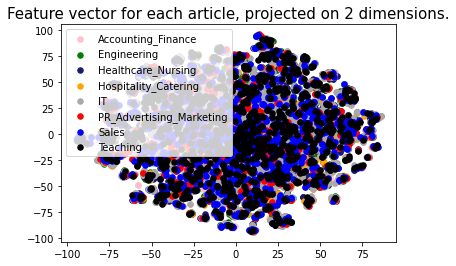

In [ ]:
# convert the document vector dataframe to a numpy array
features = preTW2v_title_dvs.to_numpy() 

# plot the tSNE to have a look
plotTSNE(df_title['Category'], features) 

<span style='font-family:Georgia;color:Blue;background:yellow'> observation
    
GoogleNews300 model is not able to seperate different titles easily and all overlap over each other. 
    
This model does not perform better than FastText in recognising differnt titles. 

In [ ]:
# saving the dataframe 
preTW2v_title_dvs.to_csv('GoogleNews300_title_unweighted.csv') 

In [ ]:
# read the csv file into a dataframe when the notebook restarts

preTW2v_title_dvs = pd.read_csv('GoogleNews300_title_unweighted.csv')

In [ ]:
preTW2v_title_dvs.head()

,Unnamed: 0,Unnamed: 0.1,0,1,2,3,4,5,6,7,...,290,291,292,293,294,295,296,297,298,299
0,0,0,0.184570,0.034424,0.412109,0.011719,-0.064453,0.080078,0.146484,0.080566,...,0.032959,0.054688,-0.322266,0.292969,-0.152344,-0.312500,-0.376953,0.014771,0.083984,-0.054688
1,1,1,-0.094727,0.000315,0.093262,-0.042236,0.078125,-0.232422,0.093262,0.107422,...,-0.174805,-0.007294,-0.096191,0.103516,-0.023682,0.064453,-0.175781,-0.004272,0.320312,-0.062988
2,2,2,0.237305,0.169922,0.123047,-0.282593,0.375977,-0.353531,-0.285156,-0.005859,...,-0.057129,0.097900,-0.106812,0.073242,0.301758,-0.260742,-0.132568,-0.662109,0.520508,0.134277
3,3,3,-0.515137,0.259094,0.212891,0.094452,-0.043457,0.128845,-0.530762,0.062500,...,-0.206055,0.021484,-0.468750,0.277832,-0.171143,-0.017700,-0.158203,0.245117,0.391602,0.618164
4,4,4,-0.071777,-0.265625,0.148438,-0.205078,-0.037598,0.104980,0.126953,0.117676,...,-0.055420,0.119141,0.053711,-0.099609,-0.018555,-0.049561,0.067383,-0.259766,0.168945,-0.163086


In [ ]:
preTW2v_title_dvs.drop("Unnamed: 0", axis=1, inplace=True)

In [ ]:
if "Unnamed: 0.1" in preTW2v_title_dvs.columns:
    preTW2v_title_dvs.drop("Unnamed: 0.1", axis=1, inplace=True)

In [ ]:
preTW2v_title_dvs.head()

,0,1,2,3,4,5,6,7,8,9,...,290,291,292,293,294,295,296,297,298,299
0,0.184570,0.034424,0.412109,0.011719,-0.064453,0.080078,0.146484,0.080566,-0.040771,0.037354,...,0.032959,0.054688,-0.322266,0.292969,-0.152344,-0.312500,-0.376953,0.014771,0.083984,-0.054688
1,-0.094727,0.000315,0.093262,-0.042236,0.078125,-0.232422,0.093262,0.107422,0.196289,-0.013733,...,-0.174805,-0.007294,-0.096191,0.103516,-0.023682,0.064453,-0.175781,-0.004272,0.320312,-0.062988
2,0.237305,0.169922,0.123047,-0.282593,0.375977,-0.353531,-0.285156,-0.005859,0.138916,0.416992,...,-0.057129,0.097900,-0.106812,0.073242,0.301758,-0.260742,-0.132568,-0.662109,0.520508,0.134277
3,-0.515137,0.259094,0.212891,0.094452,-0.043457,0.128845,-0.530762,0.062500,0.461182,-0.273438,...,-0.206055,0.021484,-0.468750,0.277832,-0.171143,-0.017700,-0.158203,0.245117,0.391602,0.618164
4,-0.071777,-0.265625,0.148438,-0.205078,-0.037598,0.104980,0.126953,0.117676,-0.054199,-0.376953,...,-0.055420,0.119141,0.053711,-0.099609,-0.018555,-0.049561,0.067383,-0.259766,0.168945,-0.163086


### Prepare for weighted model

#### FastText Weighted --> title

In [ ]:
processed_text = [[w for w in t if w in jobAdFT_wv.index_to_key] for t in df_title['tk_title_text']] 

# use the Gensim package to create a dictionary that encapsulates the mapping 
# between normalized words and their integer ids.

# creates a dictionary from the text
docs_dict = Dictionary(processed_text) 

# filtering words that appear less than 5 times
docs_dict.filter_extremes(no_below=5) 

# assign new word ids to all words, shrinking any gaps.
docs_dict.compactify() 

In [ ]:


docs_corpus = [docs_dict.doc2bow(doc) for doc in df_title['tk_title_text']] # convert corpus to Bag of Word format
model_tfidf = TfidfModel(docs_corpus, id2word=docs_dict) # fit the tfidf model
# apply model to the list of corpus document, 
# so each document is a list of tuples, (word_index, weight) for each word appears in the document
docs_tfidf  = model_tfidf[docs_corpus]

In [ ]:
docs_vecs_fastText = np.vstack([sparse2full(c, len(docs_dict)) for c in docs_tfidf])

In [ ]:
docs_vecs_fastText.shape

(55449, 3115)

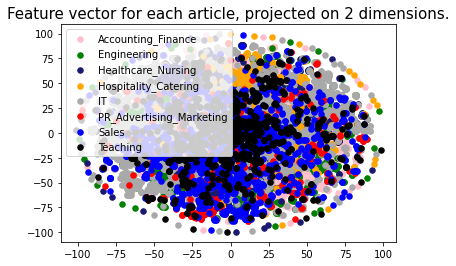

In [ ]:
# explore feature space
features = docs_vecs_fastText

plotTSNE(df_title['Category'], features)

<span style='font-family:Georgia;color:Blue;background:yellow'> observation
    
1. Fastext weighted features based on titles seem to do a bit better than GoogleNews300 unweighted but worse than  FastTest unweighted model.
    
    
2. The clusters are a bit distinguisable.  
    
3. The clusters are very close to each other.

#### GoogleNews300 Weighted --> title

In [ ]:
processed_text = [[w for w in t if w in preTW2v_wv.index_to_key] for t in df_title['tk_title_text']] 

# use the Gensim package to create a dictionary that encapsulates the mapping between normalized words and their integer ids.
docs_dict = Dictionary(processed_text) # creates a dictionary from the text
docs_dict.filter_extremes(no_below=5) # filtering words that appear less than 5 times
docs_dict.compactify() # assign new word ids to all words, shrinking any gaps.

In [ ]:
docs_corpus = [docs_dict.doc2bow(doc) for doc in df_title['tk_title_text']] # convert corpus to Bag of Word format
model_tfidf = TfidfModel(docs_corpus, id2word=docs_dict) # fit the tfidf model
# apply model to the list of corpus document, 
# so each document is a list of tuples, (word_index, weight) for each word appears in the document
docs_tfidf  = model_tfidf[docs_corpus]

In [ ]:
docs_vecs_GoogleNews300 = np.vstack([sparse2full(c, len(docs_dict)) for c in docs_tfidf])

In [ ]:
docs_vecs_GoogleNews300.shape

(55449, 2595)

In [ ]:
type(docs_vecs_GoogleNews300)

numpy.ndarray

In [ ]:
# explore feature space
features = docs_vecs_GoogleNews300

plotTSNE(df_title['Category'], features)

### Classification

In [ ]:
# lets first observe the labels into which the classification must be done
df_labels = pd.read_csv('labels.csv')

In [ ]:
df_labels.head()

,jobID,Category
0,14624,Engineering
1,31567,Healthcare_Nursing
2,50131,Hospitality_Catering
3,31419,Healthcare_Nursing
4,47238,Teaching


In [ ]:
# we observe that there are 8 categories and It has the highest number of job files in the data folder

stats = df_labels.groupby('Category').count()
print(stats)

                          jobID
Category                       
Accounting_Finance         7407
Engineering                8210
Healthcare_Nursing         8808
Hospitality_Catering       4788
IT                        14353
PR_Advertising_Marketing   2755
Sales                      5349
Teaching                   3779


<AxesSubplot:xlabel='Category'>

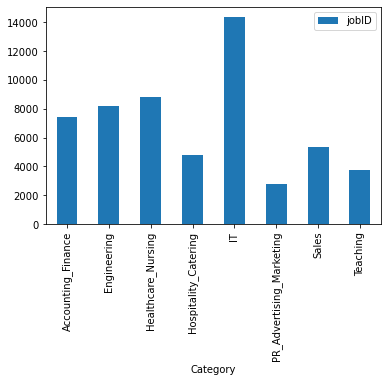

In [ ]:
stats.plot.bar(ylim=0)

In [ ]:
def gen_labels(aid_fname,df_labels):
    
    # create empty label list
    labels = [] 
    
    with open(aid_fname) as lf: 
        job_ids = lf.read().splitlines() 
        
    # for each document ID
    for aid in job_ids: 
        
        # append the corresponding label to the label list
        labels.append(df_labels.loc[df_labels.jobID == int(aid)].Category.squeeze()) 
        
    # return the list of labels and the list of document ids
    return labels, job_ids 


In [ ]:
labels, job_ids = gen_labels("job_IDs.txt", df_labels)


In [ ]:
labels

['Engineering',
 'Healthcare_Nursing',
 'Hospitality_Catering',
 'Healthcare_Nursing',
 'Teaching',
 'Healthcare_Nursing',
 'Healthcare_Nursing',
 'PR_Advertising_Marketing',
 'IT',
 'Sales',
 'IT',
 'IT',
 'Healthcare_Nursing',
 'IT',
 'Hospitality_Catering',
 'IT',
 'Engineering',
 'Sales',
 'Teaching',
 'Teaching',
 'IT',
 'IT',
 'IT',
 'Sales',
 'Hospitality_Catering',
 'Healthcare_Nursing',
 'Healthcare_Nursing',
 'IT',
 'IT',
 'IT',
 'IT',
 'Engineering',
 'Teaching',
 'Engineering',
 'Hospitality_Catering',
 'PR_Advertising_Marketing',
 'IT',
 'Engineering',
 'IT',
 'Teaching',
 'Healthcare_Nursing',
 'IT',
 'Hospitality_Catering',
 'Sales',
 'Sales',
 'Hospitality_Catering',
 'Hospitality_Catering',
 'IT',
 'IT',
 'Hospitality_Catering',
 'IT',
 'Healthcare_Nursing',
 'Healthcare_Nursing',
 'Engineering',
 'Sales',
 'Healthcare_Nursing',
 'Accounting_Finance',
 'Healthcare_Nursing',
 'PR_Advertising_Marketing',
 'IT',
 'Teaching',
 'Accounting_Finance',
 'PR_Advertising_Marketi

In [ ]:
job_ids

['14624',
 '31567',
 '50131',
 '31419',
 '47238',
 '36205',
 '30175',
 '54070',
 '05781',
 '44021',
 '02465',
 '13082',
 '36404',
 '13998',
 '51419',
 '07060',
 '18399',
 '39194',
 '44876',
 '47390',
 '08890',
 '02696',
 '00468',
 '39671',
 '52467',
 '31620',
 '32012',
 '06821',
 '13089',
 '05164',
 '01998',
 '20455',
 '46705',
 '15154',
 '50111',
 '52754',
 '09944',
 '18991',
 '10976',
 '45145',
 '30000',
 '09713',
 '50285',
 '43066',
 '43015',
 '50205',
 '49829',
 '05736',
 '13136',
 '51362',
 '09825',
 '31939',
 '30884',
 '14843',
 '42277',
 '31834',
 '28281',
 '35064',
 '53016',
 '06594',
 '46647',
 '23599',
 '53176',
 '20842',
 '54347',
 '21895',
 '04243',
 '04431',
 '39265',
 '04778',
 '28251',
 '00205',
 '25094',
 '21655',
 '54708',
 '11778',
 '19802',
 '15400',
 '47553',
 '35715',
 '29910',
 '11775',
 '12634',
 '20517',
 '01946',
 '40929',
 '28502',
 '11197',
 '21182',
 '25544',
 '04297',
 '04836',
 '47960',
 '18773',
 '43268',
 '18032',
 '28013',
 '00835',
 '22435',
 '18149',


In [ ]:
seed = 0

# creating training and test split
X_train, X_test, y_train, y_test = train_test_split(count_features_title, labels, test_size=0.33, random_state=seed)

model = LogisticRegression(random_state=seed)

model.fit(X_train, y_train)

model.score(X_test, y_test)

/Users/bhartisinha/opt/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.754194218263293

In [ ]:
y_pred = model.predict(X_test)

Text(0.5, 14.09375, 'Predicted')

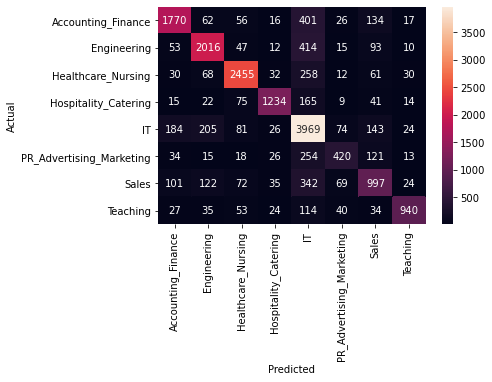

In [ ]:
conf_mat = confusion_matrix(y_test, y_pred)
conf_mat

categories = sorted(list(set(labels))) # this gives sorted set of unique label names

sns.heatmap(conf_mat, annot=True, fmt='d',
            xticklabels=categories, yticklabels=categories) # creates a heatmap from the confusion matrix
plt.ylabel('Actual')
plt.xlabel('Predicted')

In [ ]:
num_models = 4
df_models_performance_title = pd.DataFrame(columns = ['count_title', 'fastText_unweigh_title','fastText_weigh_title', 'word2vec_unweigh_title', 'word2vec_weigh_title'], index=range(num_folds)) 


fold = 0
for train_index, test_index in kf.split(list(range(0,len(labels)))):
    
    y_train = [labels[i] for i in train_index]
    y_test = [labels[i] for i in test_index]
    
    
    X_train_count, X_test_count = count_features_title[train_index], count_features_title[test_index]
    df_models_performance_title.loc[fold,'count_title'] = evaluate(count_features_title[train_index], count_features_title[test_index],
                                                       y_train, y_test, seed, type_model="count_vec")

    
    X_train_count, X_test_count = jobAdFT_title_dvs.loc[train_index], jobAdFT_title_dvs.loc[test_index]
    df_models_performance_title.loc[fold,'fastText_unweigh_title'] = evaluate(jobAdFT_title_dvs.loc[train_index], jobAdFT_title_dvs.loc[test_index],
                                                  y_train, y_test, seed)
    
    
    X_train_count, X_test_count = docs_vecs_fastText[train_index], docs_vecs_fastText[test_index]
    df_models_performance_title.loc[fold,'fastText_weigh_title'] = evaluate(docs_vecs_fastText[train_index], docs_vecs_fastText[test_index],
                                                  y_train, y_test, seed)
    

    
    X_train_count, X_test_count = docs_vecs_GoogleNews300[train_index], docs_vecs_GoogleNews300[test_index]
    df_models_performance_title.loc[fold,'word2vec_weigh_title'] = evaluate(docs_vecs_GoogleNews300[train_index], docs_vecs_GoogleNews300[test_index],
                                                  y_train, y_test, seed)
    
    
    fold +=1

/Users/bhartisinha/opt/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/bhartisinha/opt/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_mode

In [ ]:
type(docs_vecs_fastText)

In [ ]:
fold = 0
for train_index, test_index in kf.split(list(range(0,len(labels)))):
    
    y_train = [labels[i] for i in train_index]
    y_test = [labels[i] for i in test_index]


    X_train_count, X_test_count = preTW2v_title_dvs.loc[train_index], preTW2v_title_dvs.loc[test_index]
    df_models_performance_title.loc[fold,'word2vec_unweigh_title'] = evaluate(preTW2v_title_dvs.loc[train_index], preTW2v_title_dvs.loc[test_index],
                                                      y_train, y_test, seed)
        
    fold +=1


In [ ]:
df_models_performance_title

,count_title,fastText_unweigh_title,fastText_weigh_title,word2vec_unweigh_title,word2vec_weigh_title
0,0.753832,0.661407,0.755185,0.691975,0.740307
1,0.759874,0.666186,0.762218,0.705681,0.74734
2,0.755726,0.658161,0.754103,0.701713,0.740126
3,0.7578,0.666997,0.75789,0.709558,0.743823
4,0.75886,0.670124,0.760574,0.704482,0.745514


In [ ]:
df_models_performance_title.to_csv("model_performance_title")

<span style='font-family:Georgia;color:Blue;background:yellow'> observation

1. Bag of words model performs the best to predict the category of the documents based on titles features. approaxiamtely 75%

2. Weighted fastText performs similar to bag of words model with classification accuracy approximately 75%.

3. Weighted GoolgeNews300 model has accuracy of 74%. 

4. FastText unweighted has accuracy of about 66% while and GoogleNews300 unweighted had accuracy of 69%.


### 3.2.2 Document classification using Title and Description

#### Preprocess the textual data

In [ ]:
# get the title and description

job_descriptions = []

with open("job_descriptions.txt", "r") as file:
    
    descp = file.readline()[:-1]
    
    while descp:
        job_descriptions.append(descp)
        descp = file.readline()[:-1]
        
      

In [ ]:
# save titles in a list data structure for further analysis
job_titles = []

with open("job_title.txt", "r") as file:
    
    title = file.readline()[:-1]
    
    while title:
        job_titles.append(title)
        title = file.readline()[:-1]
    

In [ ]:
job_descriptions

["Our client has established itself as a leading manufacturer and supplier of quality water treatment plants, ranging from basic water softeners and reverse osmosis equipment to customer specified complex water treatment solutions. The company are able to meet their clients' requirements through flexibility in tailoring their product to their needs and budgets. Due to expansion and an increased workload they are seeking to recruit a Planet Engineer to cover accounts along the M4 Corridor Responsibilities will include conducting the routine sampling and analysis of water systems, interpreting results, maintenance and the installation of chemical dosing systems. Servicing accounts within both the industrial and commercial industries the successful candidate will complete all work in accordance to the approved code of practice. The ideal applicant for this position will have a minimum of two years relevant industry experience and will have knowledge of reverse osmosis, water softeners, wa

In [ ]:
len(job_descriptions)

55449

In [ ]:
job_titles

['Plant Engineer',
 'Residential Care Worker',
 'CHEF DE RANG FOR MICHELIN STARRED RESTAURANT',
 'Inpatient Ward Team Leader',
 'Information Services Support Analyst',
 'Physiotherapist  Cambridge',
 'Youth Justice Officer Job Luton',
 'Front End Web Developer  Slough  ****k****k',
 'NET / Web Developer  Clayton West, Huddersfield, West Yorkshire',
 'Senior Account Manager (Telecoms / IT)',
 'IT Project Manager (C/ASPnet) ****K Leicester',
 'Cisco Call Manager Technician  Greater Manchester',
 'Senior Nurse  Small Specialist Care Home',
 'Senior Oracle DBA/Database AdministratorNorth Yorkshire',
 'Cluster Sales Manager  Maternity Cover',
 'Software Build Manager, MSBuild',
 'Electrical Fitter  Crawley ,Sussex',
 'Sales Manager Door Automation',
 'Year ****/6 Teacher, Cannock',
 'Experienced KS****/KS**** Science teacher Braintree',
 'Design Engineer  Software and Firmware (Python)',
 'C Developer  Top Asset Management Firm',
 'Senior Javascript developer',
 'RESEARCHER, BOLTON',
 'Seni

In [ ]:
len(job_titles)

55449

In [ ]:
# add corresponding title and description to make one document 

desc_title = []


for title, descp in zip(job_titles, job_descriptions): 
    
    desc_title.append(title + " " + descp)
     

In [ ]:
desc_title

["Plant Engineer Our client has established itself as a leading manufacturer and supplier of quality water treatment plants, ranging from basic water softeners and reverse osmosis equipment to customer specified complex water treatment solutions. The company are able to meet their clients' requirements through flexibility in tailoring their product to their needs and budgets. Due to expansion and an increased workload they are seeking to recruit a Planet Engineer to cover accounts along the M4 Corridor Responsibilities will include conducting the routine sampling and analysis of water systems, interpreting results, maintenance and the installation of chemical dosing systems. Servicing accounts within both the industrial and commercial industries the successful candidate will complete all work in accordance to the approved code of practice. The ideal applicant for this position will have a minimum of two years relevant industry experience and will have knowledge of reverse osmosis, wate

In [ ]:
# method to convert all descriptions into sentances and then tokenize each sentence

def tokenizeAds(raw_job_ad):
    """
        This function segments the raw job description into sentences and 
        tokenize each sentences and convert the description 
        to a list of tokens.
    """        
    
    # perform sentence segmentation (i.e. segment each description text into sentences),
    sentences = sent_tokenize(raw_job_ad)
    
    # tokenize each sentence
    pattern = r'''[a-zA-Z]+(?:[-'][a-zA-Z]+)?'''

    tokenizer = RegexpTokenizer(pattern) 

    token_lists = [tokenizer.tokenize(sen) for sen in sentences]
    
    # merge them into a list of tokens
    tokenised_job_ad = list(chain.from_iterable(token_lists))
    
    return tokenised_job_ad

In [ ]:
# method to print few statistics about the tokensized list

def stats_print(tokenized_job_desc):
    
    # put all the tokens in the corpus in a single list
    words = list(chain.from_iterable(tokenized_job_desc)) 
    
    # compute the vocabulary by converting the list of words/tokens to a set,
    vocab = set(words) 
    
    # diverity of words respective of all the words in the corpus
    lexical_diversity = len(vocab)/len(words)
    
    lens = [len(job) for job in tokenized_job_desc]
    
    print("Vocabulary size: ",len(vocab))
    print("Total number of tokens: ", len(words))
    print("Lexical diversity: ", lexical_diversity)
    print("Total number of job_ad: ", len(tokenized_job_desc))
    print("Average number of tokens in job descriptions: ", np.mean(lens))
    print("Maximun number of tokens in job descriptions: ", np.max(lens))
    print("Minimun number of tokens in job descriptions: ", np.min(lens))
    print("Standard deviation of number of tokens in job descriptions: ", np.std(lens))

In [ ]:
tokenized_title_desc = [tokenizeAds(job) for job in desc_title]  

In [ ]:
tokenized_title_desc

[['Plant',
  'Engineer',
  'Our',
  'client',
  'has',
  'established',
  'itself',
  'as',
  'a',
  'leading',
  'manufacturer',
  'and',
  'supplier',
  'of',
  'quality',
  'water',
  'treatment',
  'plants',
  'ranging',
  'from',
  'basic',
  'water',
  'softeners',
  'and',
  'reverse',
  'osmosis',
  'equipment',
  'to',
  'customer',
  'specified',
  'complex',
  'water',
  'treatment',
  'solutions',
  'The',
  'company',
  'are',
  'able',
  'to',
  'meet',
  'their',
  'clients',
  'requirements',
  'through',
  'flexibility',
  'in',
  'tailoring',
  'their',
  'product',
  'to',
  'their',
  'needs',
  'and',
  'budgets',
  'Due',
  'to',
  'expansion',
  'and',
  'an',
  'increased',
  'workload',
  'they',
  'are',
  'seeking',
  'to',
  'recruit',
  'a',
  'Planet',
  'Engineer',
  'to',
  'cover',
  'accounts',
  'along',
  'the',
  'M',
  'Corridor',
  'Responsibilities',
  'will',
  'include',
  'conducting',
  'the',
  'routine',
  'sampling',
  'and',
  'analysis',

In [ ]:
len(tokenized_title_desc)

55449

In [ ]:
stats_print(tokenized_title_desc)

Vocabulary size:  114744
Total number of tokens:  14076073
Lexical diversity:  0.008151705379760392
Total number of job_ad:  55449
Average number of tokens in job descriptions:  253.85621021118504
Maximun number of tokens in job descriptions:  2005
Minimun number of tokens in job descriptions:  12
Standard deviation of number of tokens in job descriptions:  125.52516444715233


In [ ]:
# check the un-tokenized and tokenized ads

print("Raw ad:\n",job_descriptions[15],'\n')

print("Tokenized ad:\n",tokenized_title_desc[15])

Raw ad:
 Software Build Manager, MSBuild London ****k  benefits (C, MS Build, Web Deploy) Software Build Manager is required by one of the UK's leading online film and TV providers. This is a newly created role which will see you taking responsibility for the design, development and implementation of their build solution. In this role, you will be responsible the following:  All aspects of the software build and deployment process.  Configuring and distributing release builds across multiple platforms  Expected to manage the branching and merging of branches across iterations, features and milestones.  Developing and monitoring continuous integration builds.  Developing scalable, repeatable automated deployment frameworks across multiple platforms.  Manage functional test environments and support automated testing.  Promote rigorous engineering practices across the platform. Required technical skill set:  End to end software development, predominantly in C.  MS Build  Version control (

In [ ]:
# converting all to lower case
tokenized_desc_title_lower = []

for i in range(0, len(tokenized_title_desc)):
    
    # convert each token to lower case
    # create a new list with all lower case tokens for each toeknised job description
    tokenized_desc_title_lower.append([token.lower() for token in tokenized_title_desc[i]])
   

In [ ]:
tokenized_desc_title_lower

[['plant',
  'engineer',
  'our',
  'client',
  'has',
  'established',
  'itself',
  'as',
  'a',
  'leading',
  'manufacturer',
  'and',
  'supplier',
  'of',
  'quality',
  'water',
  'treatment',
  'plants',
  'ranging',
  'from',
  'basic',
  'water',
  'softeners',
  'and',
  'reverse',
  'osmosis',
  'equipment',
  'to',
  'customer',
  'specified',
  'complex',
  'water',
  'treatment',
  'solutions',
  'the',
  'company',
  'are',
  'able',
  'to',
  'meet',
  'their',
  'clients',
  'requirements',
  'through',
  'flexibility',
  'in',
  'tailoring',
  'their',
  'product',
  'to',
  'their',
  'needs',
  'and',
  'budgets',
  'due',
  'to',
  'expansion',
  'and',
  'an',
  'increased',
  'workload',
  'they',
  'are',
  'seeking',
  'to',
  'recruit',
  'a',
  'planet',
  'engineer',
  'to',
  'cover',
  'accounts',
  'along',
  'the',
  'm',
  'corridor',
  'responsibilities',
  'will',
  'include',
  'conducting',
  'the',
  'routine',
  'sampling',
  'and',
  'analysis',

In [ ]:
len(tokenized_desc_title_lower)

55449

In [ ]:
stats_print(tokenized_desc_title_lower)

Vocabulary size:  91040
Total number of tokens:  14076073
Lexical diversity:  0.006467712976481438
Total number of job_ad:  55449
Average number of tokens in job descriptions:  253.85621021118504
Maximun number of tokens in job descriptions:  2005
Minimun number of tokens in job descriptions:  12
Standard deviation of number of tokens in job descriptions:  125.52516444715233


In [ ]:
# remove words with length less than 2

descp_title = [[lowercase_token for lowercase_token in job if len(lowercase_token) >= 2] for job in tokenized_desc_title_lower]


In [ ]:
# there are three words which are of length less than 2 
print(len(tokenized_desc_title_lower[40000]))
print(len(descp_title[40000]))

375
336


In [ ]:
# print the words which are not in lowercase_tokens_lenGreater2[1000] but are in tokenized_job_desc_lower[1000]

for word in tokenized_desc_title_lower[40000]:
    if word not in descp_title[40000]:
        print(word)

c
c
c
c
c
c
a
c
a
c
a
a
c
c
c
c
c
c
c
c
c
c
c
c
c
c
c
c
c
c
c
c
c
c
c
c
c
c
c


In [ ]:
stats_print(descp_title)


Vocabulary size:  91014
Total number of tokens:  13610129
Lexical diversity:  0.006687225374572129
Total number of job_ad:  55449
Average number of tokens in job descriptions:  245.4531010478097
Maximun number of tokens in job descriptions:  1923
Minimun number of tokens in job descriptions:  12
Standard deviation of number of tokens in job descriptions:  122.16431235782046


In [ ]:
# read the stop words into a list data structure
stopwords_list = []

with open('./stopwords_en.txt') as f:
    
    stopwords_list = f.read().splitlines()

In [ ]:
stopwords_list 

['a',
 "a's",
 'able',
 'about',
 'above',
 'according',
 'accordingly',
 'across',
 'actually',
 'after',
 'afterwards',
 'again',
 'against',
 "ain't",
 'all',
 'allow',
 'allows',
 'almost',
 'alone',
 'along',
 'already',
 'also',
 'although',
 'always',
 'am',
 'among',
 'amongst',
 'an',
 'and',
 'another',
 'any',
 'anybody',
 'anyhow',
 'anyone',
 'anything',
 'anyway',
 'anyways',
 'anywhere',
 'apart',
 'appear',
 'appreciate',
 'appropriate',
 'are',
 "aren't",
 'around',
 'as',
 'aside',
 'ask',
 'asking',
 'associated',
 'at',
 'available',
 'away',
 'awfully',
 'b',
 'be',
 'became',
 'because',
 'become',
 'becomes',
 'becoming',
 'been',
 'before',
 'beforehand',
 'behind',
 'being',
 'believe',
 'below',
 'beside',
 'besides',
 'best',
 'better',
 'between',
 'beyond',
 'both',
 'brief',
 'but',
 'by',
 'c',
 "c'mon",
 "c's",
 'came',
 'can',
 "can't",
 'cannot',
 'cant',
 'cause',
 'causes',
 'certain',
 'certainly',
 'changes',
 'clearly',
 'co',
 'com',
 'come',
 'c

In [ ]:
#There are 571 stop words in the provided list

len(stopwords_list)

571

In [ ]:
# remove stop words

descp_title_stopwords = [[word for word in job if word not in stopwords_list] for job in descp_title]


In [ ]:
for word in descp_title[5000]:
    if word not in descp_title_stopwords[5000]:
        print(word, end=" ")
        
# is for in to and they with and with in particular in your as you will be for of and have of of the 
# will be very in of and these so are will have the following particularly but also and with of and some in is the over 
# of in the last and are to there is on in the of plus and up to and on for the right please through this to be 

is for in to and they with and with in particular in your as you will be for of and have of of the will be very in of and these so are will have the following particularly but also and with of and some in is the over of in the last and are to there is on in the of plus and up to and on for the right please through this to be 

In [ ]:
stats_print(descp_title_stopwords)

Vocabulary size:  90501
Total number of tokens:  8116026
Lexical diversity:  0.011150900699430978
Total number of job_ad:  55449
Average number of tokens in job descriptions:  146.36920413352811
Maximun number of tokens in job descriptions:  1136
Minimun number of tokens in job descriptions:  10
Standard deviation of number of tokens in job descriptions:  74.01848115533977


In [ ]:
# create a list of all the words used in the corpus
words_combine = list(chain.from_iterable(descp_title_stopwords)) 

In [ ]:
len(words_combine)

8116026

In [ ]:
# compute term frequency for all words
term_fd = FreqDist(words_combine) 

In [ ]:
# observe the 25 most common words in the corpus
term_fd.most_common(25)

[('experience', 104374),
 ('role', 66686),
 ('work', 64722),
 ('team', 63193),
 ('business', 61345),
 ('skills', 57959),
 ('manager', 52758),
 ('working', 52308),
 ('job', 51286),
 ('sales', 47725),
 ('client', 45505),
 ('development', 42555),
 ('support', 42241),
 ('management', 41987),
 ('company', 39244),
 ('uk', 36900),
 ('excellent', 34739),
 ('opportunity', 31324),
 ('service', 31036),
 ('required', 30459),
 ('care', 29998),
 ('knowledge', 28798),
 ('services', 26490),
 ('successful', 26022),
 ('based', 25491)]

In [ ]:
# get the words with occur only once

lessFreqWords = set(term_fd.hapaxes())
lessFreqWords

{'souschefhighqualitybritishgastrolondon',
 'addin',
 'greu',
 'cncsettercitizenslidinghead',
 'kbis',
 'handeye',
 'bryd',
 'accountingproficient',
 'respnsible',
 'datagathering',
 "inspector's",
 'developmentmanagerjavaenterprise',
 'llafur',
 'wideyou',
 'areaoperativesacrossukwantedtopromotenewweddingwebsite',
 'lia',
 'homehold',
 'compriseit',
 'turnyourgaminghobbyintoacareerimmediatestart',
 'belfon',
 'qualityhealthandsafetymanagerrugbycentre',
 'essentialspring',
 'foundationstageteacherwarwickshire',
 'salesassistantnoexperienceneeded',
 'edgehealth',
 'oraclehrmspayrollleadconsultantr',
 'brwdfrydig',
 'cheftournantanglofrench',
 'essentialwe',
 'immediatelymichael',
 'pookchangeinternational',
 'accountexecutivesandsaesprlondoncirca',
 'windleirweb',
 'supportedhousingprojectworkerhalstead',
 'websiteessentialemploy',
 'reviewdriven',
 'filmgamesalesadvisor',
 'chloewhilockassuredrecruit',
 'incircuit',
 'assistantmanagerbristolitalianrestaurant',
 'prefereble',
 'desatura

In [ ]:
# remove these less frequent words from each tokenized job description
def removeLessFreqWords(ad):
    return [w for w in ad if w not in lessFreqWords]

In [ ]:
descp_title = [removeLessFreqWords(job) for job in descp_title_stopwords]

In [ ]:
stats_print(descp_title)

Vocabulary size:  40815
Total number of tokens:  8066340
Lexical diversity:  0.0050599156494767145
Total number of job_ad:  55449
Average number of tokens in job descriptions:  145.4731374776822
Maximun number of tokens in job descriptions:  1125
Minimun number of tokens in job descriptions:  10
Standard deviation of number of tokens in job descriptions:  73.69517643691876


In [ ]:
words_2 = list(chain.from_iterable([set(job) for job in descp_title]))
doc_fd = FreqDist(words_2)  
doc_fd.most_common(50)

[('experience', 43664),
 ('role', 34713),
 ('work', 33697),
 ('team', 32622),
 ('working', 30718),
 ('skills', 30418),
 ('client', 26914),
 ('job', 25702),
 ('business', 24787),
 ('uk', 24192),
 ('excellent', 23030),
 ('opportunity', 22749),
 ('company', 22304),
 ('required', 20935),
 ('management', 20654),
 ('development', 20319),
 ('apply', 20140),
 ('based', 19400),
 ('successful', 19119),
 ('join', 18687),
 ('salary', 18421),
 ('www', 18421),
 ('support', 18389),
 ('cv', 18383),
 ('knowledge', 17844),
 ('manager', 16569),
 ('strong', 16480),
 ('environment', 16418),
 ('posted', 16398),
 ('jobseeking', 16342),
 ('candidate', 16304),
 ('originally', 16294),
 ('leading', 16246),
 ('high', 15963),
 ('service', 15684),
 ('good', 15263),
 ('ability', 15154),
 ('including', 14858),
 ('services', 14585),
 ('position', 14577),
 ('benefits', 14480),
 ('training', 14235),
 ('essential', 13927),
 ('experienced', 13888),
 ('level', 13584),
 ('key', 13582),
 ('contact', 13553),
 ('recruitment', 

In [ ]:
document_freq = doc_fd.most_common(50)
document_freq 

[('experience', 43664),
 ('role', 34713),
 ('work', 33697),
 ('team', 32622),
 ('working', 30718),
 ('skills', 30418),
 ('client', 26914),
 ('job', 25702),
 ('business', 24787),
 ('uk', 24192),
 ('excellent', 23030),
 ('opportunity', 22749),
 ('company', 22304),
 ('required', 20935),
 ('management', 20654),
 ('development', 20319),
 ('apply', 20140),
 ('based', 19400),
 ('successful', 19119),
 ('join', 18687),
 ('salary', 18421),
 ('www', 18421),
 ('support', 18389),
 ('cv', 18383),
 ('knowledge', 17844),
 ('manager', 16569),
 ('strong', 16480),
 ('environment', 16418),
 ('posted', 16398),
 ('jobseeking', 16342),
 ('candidate', 16304),
 ('originally', 16294),
 ('leading', 16246),
 ('high', 15963),
 ('service', 15684),
 ('good', 15263),
 ('ability', 15154),
 ('including', 14858),
 ('services', 14585),
 ('position', 14577),
 ('benefits', 14480),
 ('training', 14235),
 ('essential', 13927),
 ('experienced', 13888),
 ('level', 13584),
 ('key', 13582),
 ('contact', 13553),
 ('recruitment', 

In [ ]:
freq_words = []

for word in document_freq:
    freq_words.append(word[0])
    
print(freq_words)
print("\n")
print(len(freq_words ))

['experience', 'role', 'work', 'team', 'working', 'skills', 'client', 'job', 'business', 'uk', 'excellent', 'opportunity', 'company', 'required', 'management', 'development', 'apply', 'based', 'successful', 'join', 'salary', 'www', 'support', 'cv', 'knowledge', 'manager', 'strong', 'environment', 'posted', 'jobseeking', 'candidate', 'originally', 'leading', 'high', 'service', 'good', 'ability', 'including', 'services', 'position', 'benefits', 'training', 'essential', 'experienced', 'level', 'key', 'contact', 'recruitment', 'candidates', 'provide']


50


In [ ]:
def removeTop50(ad):
    return [w for w in ad if w not in freq_words]

In [ ]:
descp_title = [removeTop50(ad) for ad in descp_title]

In [ ]:
stats_print(descp_title)


Vocabulary size:  40765
Total number of tokens:  6464273
Lexical diversity:  0.006306200248659052
Total number of job_ad:  55449
Average number of tokens in job descriptions:  116.58051542859204
Maximun number of tokens in job descriptions:  994
Minimun number of tokens in job descriptions:  7
Standard deviation of number of tokens in job descriptions:  62.05726025865222


In [ ]:
words = list(chain.from_iterable(descp_title))

In [ ]:
descp_title

[['plant',
  'engineer',
  'established',
  'manufacturer',
  'supplier',
  'quality',
  'water',
  'treatment',
  'plants',
  'ranging',
  'basic',
  'water',
  'softeners',
  'reverse',
  'osmosis',
  'equipment',
  'customer',
  'complex',
  'water',
  'treatment',
  'solutions',
  'meet',
  'clients',
  'requirements',
  'flexibility',
  'tailoring',
  'product',
  'budgets',
  'due',
  'expansion',
  'increased',
  'workload',
  'seeking',
  'recruit',
  'planet',
  'engineer',
  'cover',
  'accounts',
  'corridor',
  'responsibilities',
  'include',
  'conducting',
  'routine',
  'sampling',
  'analysis',
  'water',
  'systems',
  'interpreting',
  'results',
  'maintenance',
  'installation',
  'chemical',
  'dosing',
  'systems',
  'servicing',
  'accounts',
  'industrial',
  'commercial',
  'industries',
  'complete',
  'accordance',
  'approved',
  'code',
  'practice',
  'ideal',
  'applicant',
  'minimum',
  'years',
  'relevant',
  'industry',
  'reverse',
  'osmosis',
  '

In [ ]:
vocab_combine = set(words)

In [ ]:
vocab_combine

{'requirementpegasusresource',
 'charities',
 "rscn's",
 'ninewells',
 "needn't",
 'physician',
 'heartrelated',
 'deputize',
 'prac',
 'directives',
 'partially',
 'topside',
 'companies',
 'attorneys',
 'decreases',
 'publisher',
 'esm',
 'podiatrists',
 'xendesktop',
 'servicedeskanalyst',
 'leachkin',
 'docx',
 'formalising',
 'thrilled',
 'formulation',
 'studentship',
 'specially',
 'federations',
 'monthcontract',
 'factories',
 'pega',
 'cafe',
 "resourcing's",
 'oli',
 'servicespecific',
 'unknown',
 'iwm',
 'resisdents',
 'llps',
 'payroll',
 'arsenal',
 'pop',
 'eggplant',
 'early',
 'changeover',
 'divided',
 'booker',
 'nppv',
 'implants',
 'dagenham',
 'fall',
 'thunderhead',
 'remains',
 'doctrine',
 'deli',
 'ojavascript',
 'living',
 'inco',
 'hailsham',
 'fractionalm',
 'grocockrandstadfp',
 'lawyers',
 'rapidchange',
 'chaos',
 'corn',
 'proxys',
 'keeper',
 'dataset',
 'unlawful',
 'cfc',
 'js',
 'somerville',
 'rendered',
 'leeds',
 'gll',
 'amf',
 'fortunate',
 'd

In [ ]:
len(vocab_combine)

40765

In [ ]:
vocab_combine = sorted(list(vocab_combine))

In [ ]:
out_file = open("vocab_combine.txt", 'w')

for ind in range(0, len(vocab_combine)):
    out_file.write("{}:{}\n".format(vocab_combine[ind],ind)) # write each index and vocabulary word, note that index start from 0
out_file.close() # close the file

In [ ]:
vocab_combine

["a'level",
 'aa',
 'aaa',
 'aaappointments',
 'aab',
 'aac',
 'aacc',
 'aae',
 'aah',
 'aak',
 'aamm',
 'aan',
 'aand',
 'aantrekkelijk',
 'aap',
 'aar',
 'aarca',
 'aardman',
 'aareon',
 'aaron',
 'aaronwallis',
 'aarosette',
 'aarosettehotel',
 'aarosettelivein',
 'aarosetterestaurant',
 'aarosetterestaurantlondon',
 'aarosettes',
 'aarosettesinternationalchainofhotels',
 'aarosetteslivein',
 'aasl',
 'aasp',
 'aastra',
 'aat',
 'aatom',
 'ab',
 'aba',
 'abab',
 'abacus',
 'abaility',
 'abandoned',
 'abandonment',
 'abandons',
 'abap',
 'abaqus',
 'abatement',
 'abb',
 'abbas',
 'abbey',
 'abbeywood',
 'abbie',
 'abbot',
 'abbots',
 'abbott',
 'abby',
 'abbyy',
 'abc',
 'abd',
 'abdo',
 'abdominal',
 'abdul',
 'abdulla',
 'abel',
 'abellprotocoleducation',
 'abenefit',
 'aberdare',
 'aberdeen',
 "aberdeen's",
 'aberdeenshire',
 'aberdenshire',
 'aberfeldy',
 'abergavenny',
 'abertillery',
 'aberystwyth',
 'abfa',
 'abgeschlossenes',
 'abi',
 'abid',
 'abide',
 'abiding',
 'abigail',

Continued on Document_Modeling_3.ipynb